In [1]:
import sys
import os
from pathlib import Path

sys.path.append("inz/dahitra")
from models.networks import define_G

In [2]:
import sys
from pathlib import Path
from typing import Any, Callable

import dotenv
import pytorch_lightning as pl
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchmetrics
import torchmetrics.classification
import torchmetrics.segmentation
from matplotlib import pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint, RichProgressBar
from simplecv.module import fpn
from torch import Tensor
import torchvision.transforms as T

from inz.models.base_pl_module import BasePLModule
from inz.data.data_module import XBDDataModule
from inz.data.event import Event, Hold, Test, Tier1, Tier3
from inz.util import get_wandb_logger, show_masks_comparison

In [3]:
# from types import SimpleNamespace

In [4]:
# args_dict = {
#     "img_size": 512,
#     "checkpoint_root": "delete_me",
#     "lr_policy": "linear"
# }

# args = SimpleNamespace(**args_dict)

# define_G(args=args, gpu_ids=[0])

In [5]:
dotenv.load_dotenv()
RANDOM_SEED = 123
pl.seed_everything(RANDOM_SEED)
device = torch.device("cuda")
torch.set_float32_matmul_precision("high")

Seed set to 123


In [6]:
cwd = Path().resolve()
os.chdir(cwd / "inz/dahitra/xBD_code")
print(Path().resolve())
from xBD_code.zoo.model_transformer_encoding import BASE_Transformer_UNet, Discriminator
from losses import ComboLoss


os.chdir(cwd)

/home/tomek/inz/inz/inz/dahitra/xBD_code


In [7]:
# model = BASE_Transformer_UNet(
#     input_nc=3,
#     output_nc=5,
#     token_len=4,
#     resnet_stages_num=4,
#     with_pos="learned",
#     with_decoder_pos="learned",
#     enc_depth=1,
#     dec_depth=8,
# ).to(device)

# IMG_SIZE = 512
# scale_factor = IMG_SIZE / 1024

# # hack positonal embedding sizes to enable 512px images
# dim_5, dim_4, dim_3, dim_2 = 32, 32, 32, 32
# model.pos_embedding_decoder_5 = nn.Parameter(torch.randn(1, dim_5, int(16 * scale_factor), int(16 * scale_factor)))
# model.pos_embedding_decoder_4 = nn.Parameter(torch.randn(1, dim_4, int(32 * scale_factor), int(32 * scale_factor)))
# model.pos_embedding_decoder_3 = nn.Parameter(torch.randn(1, dim_3, int(64 * scale_factor), int(64 * scale_factor)))

# model = model.to(device)
# model

In [8]:
# imgs = torch.rand((8, 6, 512, 512)).to(device)
# with torch.no_grad():
#     model(imgs)

In [9]:
class DahitraModule(nn.Module):
    def __init__(self, *args, image_size: int = 1024, **kwargs) -> None:
        super(DahitraModule, self).__init__()
        self.module = BASE_Transformer_UNet(*args, **kwargs)

        scale_factor = image_size / 1024

        # hack positonal embedding sizes to enable 512px images
        dim_5, dim_4, dim_3, dim_2 = 32, 32, 32, 32
        self.module.pos_embedding_decoder_5 = nn.Parameter(
            torch.randn(1, dim_5, int(16 * scale_factor), int(16 * scale_factor))
        )
        self.module.pos_embedding_decoder_4 = nn.Parameter(
            torch.randn(1, dim_4, int(32 * scale_factor), int(32 * scale_factor))
        )
        self.module.pos_embedding_decoder_3 = nn.Parameter(
            torch.randn(1, dim_3, int(64 * scale_factor), int(64 * scale_factor))
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.module(x)


class DahitraPLModule(BasePLModule):
    def __init__(
        self,
        model: nn.Module,
        loss: nn.Module,
        optimizer_factory: Callable[[Any], torch.optim.Optimizer],
        scheduler_factory: Callable[[Any], torch.optim.lr_scheduler.LRScheduler] | None = None,
        class_weights: Tensor | None = None,
    ):
        super(DahitraPLModule, self).__init__(
            model=model,
            optimizer_factory=optimizer_factory,
            scheduler_factory=scheduler_factory,
            class_weights=class_weights,
        )

        self._loss = loss

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.model.forward(x)

    def loss(
        self, images_pre: Tensor, masks_pre: Tensor, images_post: Tensor, masks_post: Tensor
    ) -> tuple[Tensor, Tensor]:
        preds = self.forward(torch.cat([images_pre, images_post], dim=1))
        loss0 = self._loss(preds[:, 0, ...], masks_post[:, 0, ...])
        loss1 = self._loss(preds[:, 1, ...], masks_post[:, 1, ...])
        loss2 = self._loss(preds[:, 2, ...], masks_post[:, 2, ...])
        loss3 = self._loss(preds[:, 3, ...], masks_post[:, 3, ...])
        loss4 = self._loss(preds[:, 4, ...], masks_post[:, 4, ...])
        stacked = torch.stack([loss0, loss1, loss2, loss3, loss4])
        loss = (stacked * self.class_weights).sum()
        return loss, stacked

In [10]:
BATCH_SIZE = 32

dm = XBDDataModule(
    path=Path("data/xBD_processed_512"),
    drop_unclassified_channel=True,
    events={
        Tier3: [
            Event.joplin_tornado,
            Event.moore_tornado,
            Event.nepal_flooding,
            Event.pinery_bushfire,
        ],
    },
    val_fraction=0.15,
    test_fraction=0.0,
    train_batch_size=BATCH_SIZE,
    val_batch_size=BATCH_SIZE,
    test_batch_size=BATCH_SIZE,
    transform=T.Compose(
        transforms=[
            T.RandomHorizontalFlip(p=0.5),
            T.RandomApply(
                p=0.6, transforms=[T.RandomAffine(degrees=(-10, 10), scale=(0.9, 1.1), translate=(0.1, 0.1))]
            ),
        ]
    ),
)
dm.prepare_data()
dm.setup("fit")

print(f"{len(dm.train_dataloader())} train batches, {len(dm.val_dataloader())} val batches")

302 train batches, 54 val batches


In [11]:
m = next(iter(dm.train_dataloader()))

In [12]:
images_pre = m[0]
print(images_pre.min())
print(images_pre.max())

tensor(-1.)
tensor(1.)


In [13]:
# original weights
class_weights = torch.Tensor([0.05, 0.2, 0.8, 0.7, 0.4]).to(device)
model = DahitraPLModule(
    model=DahitraModule(
        image_size=512,
        input_nc=3,
        output_nc=5,
        token_len=4,
        resnet_stages_num=4,
        with_pos="learned",
        with_decoder_pos="learned",
        enc_depth=1,
        dec_depth=8,
    ).to(device),
    loss=ComboLoss({'dice': 1, 'focal': 8}, per_image=False).to(device),
    class_weights=class_weights,
    optimizer_factory=lambda params: torch.optim.AdamW(params, lr=0.0001, weight_decay=1e-6),
    scheduler_factory=lambda optimizer: torch.optim.lr_scheduler.MultiStepLR(
        optimizer=optimizer, milestones=[5, 11, 23, 29, 33, 47, 50, 60, 70, 90, 110, 130, 150, 170, 180, 190], gamma=0.6
    ),
).to(device)

using UNet Transformer !!!!


In [14]:
wandb_logger = get_wandb_logger(run_name="Delete me")

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: tomasz-owienko-stud (tomasz-owienko-stud-warsaw-university-of-technology). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /home/tomek/.netrc


In [15]:
trainer = pl.Trainer(
    max_epochs=15,
    callbacks=[
        RichProgressBar(),
        # ModelCheckpoint(
        #     dirpath="delete_me",
        #     save_last="link",
        #     save_top_k=1,
        #     monitor="epoch",
        #     mode="max",
        #     filename="farseg_test_original_split-{epoch:02d}-{step:03d}-{f1:.6f}-last"
        # ),
        # ModelCheckpoint(
        #     dirpath="delete_me",
        #     save_last="link",
        #     save_top_k=2,
        #     monitor="f1",
        #     mode="max",
        #     filename="farseg_test_original_split-{epoch:02d}-{step:03d}-{f1:.6f}-best-f1"
        # ),
        # ModelCheckpoint(
        #     dirpath="delete_me",
        #     save_last="link",
        #     save_top_k=2,
        #     monitor="val_loss",
        #     mode="min",
        #     filename="farseg_test_original_split-{epoch:02d}-{step:03d}-{f1:.6f}-best-val-loss"
        # )
    ],
    precision="bf16",
    logger=wandb_logger,
    gradient_clip_val=0.999, gradient_clip_algorithm="norm"
)
trainer.fit(model, datamodule=dm)

/home/tomek/inz/inz/.venv/lib/python3.11/site-packages/lightning_fabric/connector.py:563: `precision=bf16` is supported for historical reasons but its usage is discouraged. Please set your precision to bf16-mixed instead!
Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tomek/inz/inz/.venv/lib/python3.11/site-packages/pytorch_lightning/utilities/parsing.py:44: attribute 'optimizer_factory' removed from hparams because it cannot be pickled
/home/tomek/inz/inz/.venv/lib/python3.11/site-packages/pytorch_lightning/utilities/parsing.py:44: attribute 'scheduler_factory' removed from hparams because it cannot be pickled


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃    ┃ Name                     ┃ Type                ┃ Params ┃
┡━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│ 0  │ model                    │ DahitraModule       │ 13.1 M │
│ 1  │ accuracy_loc             │ BinaryAccuracy      │      0 │
│ 2  │ iou_loc                  │ MeanIoU             │      0 │
│ 3  │ f1                       │ MulticlassF1Score   │      0 │
│ 4  │ precision                │ MulticlassPrecision │      0 │
│ 5  │ recall                   │ MulticlassRecall    │      0 │
│ 6  │ iou                      │ MeanIoU             │      0 │
│ 7  │ f1_per_class             │ MulticlassF1Score   │      0 │
│ 8  │ precision_per_class      │ MulticlassPrecision │      0 │
│ 9  │ recall_per_class         │ MulticlassRecall    │      0 │
│ 10 │ iou_per_class            │ MeanIoU             │      0 │
│ 11 │ f1_loc                   │ BinaryF1Score       │      0 │
│ 12 │ accuracy_loc_safe        │ BinaryAccuracy      │      0 │
│ 13 │ iou_loc_safe             │ MeanIoU             │      0 │
│ 14 │ f1_safe                  │ MulticlassF1Score   │      0 │
│ 15 │ precision_safe           │ MulticlassPrecision │      0 │
│ 16 │ recall_safe              │ MulticlassRecall    │      0 │
│ 17 │ iou_safe                 │ MeanIoU             │      0 │
│ 18 │ f1_per_class_safe        │ MulticlassF1Score   │      0 │
│ 19 │ precision_per_class_safe │ MulticlassPrecision │      0 │
│ 20 │ recall_per_class_safe    │ MulticlassRecall    │      0 │
│ 21 │ iou_per_class_safe       │ MeanIoU             │      0 │
│ 22 │ f1_loc_safe              │ BinaryF1Score       │      0 │
│ 23 │ _loss                    │ ComboLoss           │      0 │
└────┴──────────────────────────┴─────────────────────┴────────┘

Trainable params: 13.1 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 13.1 M                                                                                               
Total estimated model params size (MB): 52

Output()

/home/tomek/inz/inz/.venv/lib/python3.11/site-packages/pytorch_lightning/trainer/call.py:54: Detected 
KeyboardInterrupt, attempting graceful shutdown...

In [ ]:
model.eval()

DahitraPLModule(
  (model): DahitraModule(
    (module): BASE_Transformer_UNet(
      (resnet): ResNet(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu): ReLU(inplace=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          )
          (1): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size

In [ ]:
it = iter(dm.val_dataloader())


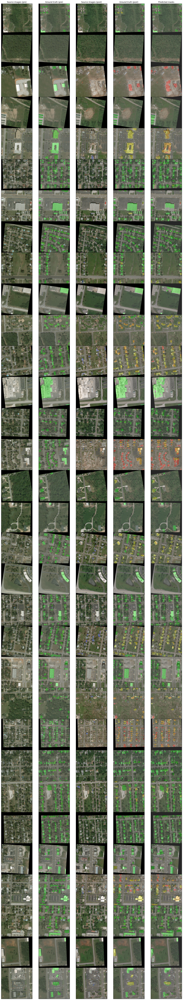

In [ ]:
batch = next(it)
images_pre, masks_pre, images_post, masks_post = batch
with torch.no_grad():
    m = model.to(device)
    preds = m(torch.cat([images_pre, images_post], dim=1).to(device))

plt.rcParams["savefig.bbox"] = "tight"
plt.rcParams["figure.figsize"] = [20, 120]

show_masks_comparison(
    images_pre=images_pre, images_post=images_post, masks_pre=masks_pre, masks_post=masks_post, preds=preds, opacity=0.3
)